In [38]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.style as style
from tqdm import tqdm 
plt.rcParams.update({'axes.labelsize':16})
plt.rcParams.update({'axes.titlesize':16})
plt.rcParams.update({'legend.fontsize':16})
plt.rcParams['xtick.labelsize'] = 16
plt.rcParams['ytick.labelsize'] = 16
plt.rcParams['lines.linewidth'] = 4
style.use('ggplot')
import os
os.chdir('../')
from data_processing import helper_functions, find_fips_for_depts
os.chdir('notebooks')

## find fips codes corresponding to departments

In [39]:
df_fips = find_fips_for_depts.make_fips_df(file_path='../raw_data/census_counts.csv')

## process incident counts for each department


In [40]:
df = pd.read_csv('../raw_data/all_depts.csv')
df['date'] = pd.to_datetime(df['date'])
df['year'] = df['date'].dt.year
df['month'] = df['date'].dt.month
df['day_of_week'] = df['date'].apply(lambda x: x.day_name())
df = df[df['date'] > pd.to_datetime('2019-1-1')]
df = df[df['date'] < pd.to_datetime('2021-1-1')]
df['department_name'] = df['department_name'].str.replace(r" \(.*\)",'', regex=True)
df = df.groupby('department_name').filter(lambda x: np.sum(x['count']) >  0)
df = df[df['department_name'] != 'Fairfax County Fire and Rescue Department']

In [41]:
df_cleaned = df.groupby('department_name').apply(helper_functions.remove_outliers, sig=.02).reset_index(drop=True)


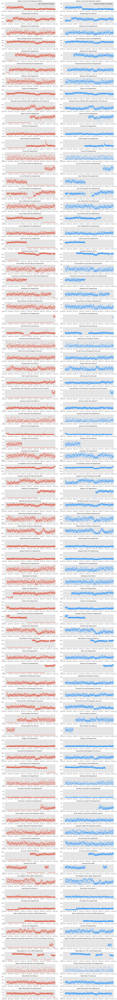

In [42]:
fig = plt.figure(figsize=(20, 170), facecolor='white')
departments = df['department_name'].unique()
for n, dept in enumerate(departments):
    plt.subplot(len(departments), 2, 2*n+1)
    df_not_avg = df_cleaned[df_cleaned['department_name'] == dept]
    df_raw = df[df['department_name'] == dept]
    plt.scatter(df_raw['date'], df_raw['count'], alpha=.5, label='raw number of incidents')
    plt.xlim(pd.to_datetime('2019-1-1'),  pd.to_datetime('2021-1-1'))
    plt.title(dept, fontsize=16)
    plt.ylim(df_raw['count'].min(), df_raw['count'].max())
    if n == 0:
        plt.legend()
    
    plt.subplot(len(departments), 2, 2*n+2)
    plt.scatter(df_not_avg['date'], df_not_avg['count'], alpha=.5, label='cleaned number of incidents', color='dodgerblue')
    plt.xlim(pd.to_datetime('2019-1-1'),  pd.to_datetime('2021-1-1'))
    plt.title(dept, fontsize=16)
    plt.ylim(df_raw['count'].min(), df_raw['count'].max())
    if n == 0:
        plt.legend()
    
plt.tight_layout()
plt.savefig('../figures/no_outliers.png', facecolor=fig.get_facecolor(), dpi=300)

In [27]:
df_ch_baseline = df_cleaned.groupby('department_name').apply(helper_functions.apply_baseline_to_df).reset_index(drop=True)
df_ch_baseline_avg = df_ch_baseline.groupby('department_name').apply(helper_functions.average_baseline_change_weekly).reset_index(level=1, drop=True).reset_index()


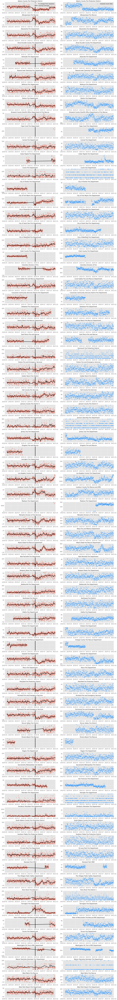

In [43]:
fig = plt.figure(figsize=(20, 170), facecolor='white')
departments = df_ch_baseline['department_name'].unique()
for n, dept in enumerate(departments):
    
    plt.subplot(len(departments), 2, 2*n+1)
    df_ch_dept = df_ch_baseline[df_ch_baseline['department_name'] == dept]
    df_ch_dept_avg = df_ch_baseline_avg[df_ch_baseline_avg['department_name'] == dept]
    plt.scatter(df_ch_dept['date'], df_ch_dept['change_from_baseline'], alpha=.5, label='% change from baseline')
    plt.plot(df_ch_dept_avg['date'], df_ch_dept_avg['avg_change_baseline_incidents'], color='black', label='moving average', alpha=.8)
    plt.xlim(pd.to_datetime('2019-1-1'),  pd.to_datetime('2021-1-1'))
    plt.title(dept, fontsize=16)
    plt.axvline(x=pd.to_datetime('2020-3-15'),color='black')
    if n == 0:
        plt.legend()
    plt.subplot(len(departments), 2, 2*n+2)
    df_not_avg = df_cleaned[df_cleaned['department_name'] == dept]
    plt.scatter(df_not_avg['date'], df_not_avg['count'], alpha=.5, label='cleaned count data', color='dodgerblue')
    plt.xlim(pd.to_datetime('2019-1-1'),  pd.to_datetime('2021-1-1'))
    plt.title(dept, fontsize=16)
    if n == 0:
        plt.legend()

plt.tight_layout()
plt.savefig('../figures/baseline_plots.png', facecolor=fig.get_facecolor(), dpi=300)

## process google data

In [44]:
df_2020_google = pd.read_csv('../raw_data/google_data/2020_US_Region_Mobility_Report.csv')
df_2020_google['date'] = pd.to_datetime(df_2020_google['date'])
df_2020_google = df_2020_google.dropna(subset='census_fips_code')
df_2020_google['county_fips_code'] = df_2020_google['census_fips_code'].astype(int)
df_2020_google = df_2020_google[['date', 'county_fips_code', 'retail_and_recreation_percent_change_from_baseline', 'grocery_and_pharmacy_percent_change_from_baseline', 'parks_percent_change_from_baseline', 'workplaces_percent_change_from_baseline', 'residential_percent_change_from_baseline']]
df_2020_google = df_2020_google.rename(columns={'retail_and_recreation_percent_change_from_baseline':'retail/recreation', 'grocery_and_pharmacy_percent_change_from_baseline':'grocery/pharmacy', 'parks_percent_change_from_baseline':'parks', 'workplaces_percent_change_from_baseline':'workplace', 'residential_percent_change_from_baseline':'residential'})
df_google_with_department = pd.merge(df_2020_google, df_fips, on='county_fips_code')
df_google_with_department['year'] = df_google_with_department['date'].dt.year
df_google_with_department['month'] = df_google_with_department['date'].dt.month
df_google_with_department['day_of_week'] = df_google_with_department['date'].apply(lambda x: x.day_name())
df_google_with_department = df_google_with_department.dropna()
df_google_weekly = df_google_with_department.groupby('department_name').apply(helper_functions.average_mobility_data).reset_index(level=1, drop=True).reset_index()

In [46]:
mobility_types = df_google_with_department.columns[2:7]

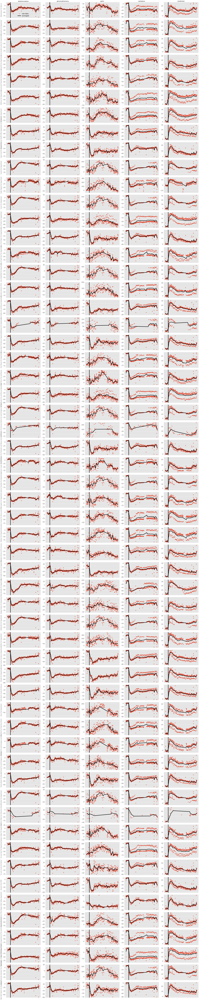

In [47]:
fig = plt.figure(figsize=(30, 150), facecolor='white')
departments = df_google_weekly['department_name'].unique()
for n, dept in enumerate(departments):
    df_raw = df_google_with_department[df_google_with_department['department_name'] == dept]
    df_avg = df_google_weekly[df_google_weekly['department_name'] == dept]
    for i, mob_type in enumerate(mobility_types):
        plt.subplot(len(departments), len(mobility_types), len(mobility_types)*n+i+1)
        plt.scatter(df_raw['date'], df_raw[mob_type], label='raw data')
        plt.plot(df_avg['date'], df_avg[mob_type + '_avg'], label='averaged', color='black')
        plt.xticks([])
        plt.axvline(x=pd.to_datetime('2020-3-15'),color='black')  
        if n == 0:
            plt.title(mob_type)
            if i == 0:
                plt.legend()
        if i == 0:
            plt.ylabel(dept)
        plt.xticks([])
        plt.axvline(x=pd.to_datetime('2020-3-15'),color='black')
        
plt.tight_layout()
plt.savefig('../figures/google_data.png', facecolor=fig.get_facecolor(), dpi=300)

## merge google and incident data

In [34]:
all_data = pd.merge(df_google_weekly, df_ch_baseline_avg, on=['date', 'department_name'], how='inner')
all_data.to_csv('../formatted_data/all_data.csv', index=False)

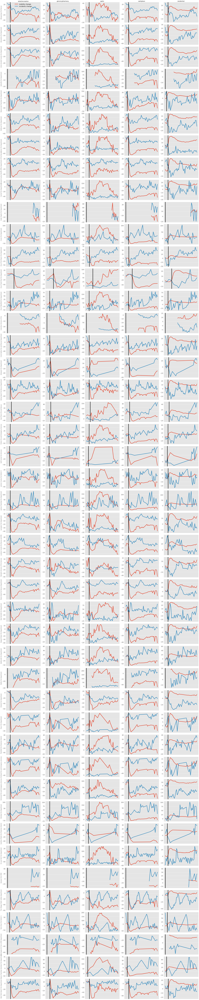

In [35]:
fig = plt.figure(figsize=(30, 150), facecolor='white')
departments = all_data['department_name'].unique()
for n, dept in enumerate(departments):
    df_dept = all_data[all_data['department_name'] == dept]
    for i, mob_type in enumerate(mobility_types):
        plt.subplot(len(departments), len(mobility_types), len(mobility_types)*n+i+1)
        plt.plot(df_dept['date'], df_dept[mob_type + '_avg'], label='mobility change')
        plt.plot(df_dept['date'], df_dept['avg_change_baseline_incidents'], label='incidents change')
        if n == 0:
            plt.title(mob_type)
            if i == 0:
                plt.legend()
        if i == 0:
            plt.ylabel(dept)
        plt.xticks([])
        plt.axvline(x=pd.to_datetime('2020-3-15'),color='black')
                
plt.tight_layout()
plt.savefig('../figures/all_data.png', facecolor=fig.get_facecolor(), dpi=300)

In [36]:
all_data

,department_name,date,retail/recreation_avg,grocery/pharmacy_avg,parks_avg,workplace_avg,residential_avg,avg_change_baseline_incidents
0,Albuquerque Fire Rescue,2020-02-17,8.666667,8.666667,29.333333,-7.333333,0.666667,25.113500
1,Albuquerque Fire Rescue,2020-02-24,3.428571,5.000000,0.142857,1.714286,0.000000,19.057931
2,Albuquerque Fire Rescue,2020-03-02,12.000000,10.428571,20.428571,3.428571,-1.714286,17.737026
3,Albuquerque Fire Rescue,2020-03-09,10.857143,13.142857,28.142857,3.000000,-1.285714,19.379999
4,Albuquerque Fire Rescue,2020-03-16,0.857143,25.142857,21.571429,-6.142857,2.142857,19.387639
...,...,...,...,...,...,...,...,...
1561,West Palm Beach Fire Department,2020-11-02,-21.571429,-12.428571,-23.857143,-25.571429,7.571429,-4.008862
1562,West Palm Beach Fire Department,2020-11-09,-25.857143,-16.571429,-40.142857,-29.857143,10.714286,-6.111121
1563,West Palm Beach Fire Department,2020-11-16,-21.571429,-14.142857,-27.571429,-26.142857,8.428571,1.061021
1564,West Palm Beach Fire Department,2020-11-23,-20.428571,-11.857143,-28.000000,-25.571429,7.857143,-6.605354
